# manual fixation labelling

In [1]:
# import 
import numpy as np
import pandas as pd
# %matplotlib widget
# %matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import matplotlib.cm as cm
from matplotlib.animation import FuncAnimation
import itertools
import random
import seaborn as sns
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

from src.d03_processing.BlinkProcessor import BlinkProcessor
from src.d03_processing.fixations.SignalProcessor import SignalProcessor
from src.d03_processing.fixations.I_VDT import I_VDT
from src.d00_utils.TaskObjects import *
from src.d03_processing.fixations.FixationProcessor import FixationProcessor
from src.d03_processing.TimepointProcessor import TimepointProcessor
from src.d01_data.fetch.fetch_timepoints import fetch_timepoints
from src.d01_data.fetch.fetch_viewings import fetch_viewings
from src.d01_data.fetch.fetch_trials import fetch_trials
from src.d01_data.fetch.fetch_timepoints import fetch_timepoints
from src.d03_processing.aoi import collision_sphere_radius
from src.d03_processing.feature_extract.to_viewing import to_viewing
from src.d03_processing.preprocess import preprocess_timepoints
from src.d03_processing.fixations.FixAlgos import *
from src.d00_utils.TaskObjects import *

import plotly.graph_objects as go

import dash
from jupyter_dash import JupyterDash
import dash_core_components as dcc
from dash import html 
from dash.dependencies import Input, Output, State
import plotly.graph_objects as go
import pandas as pd

C:\Users\Luke\AppData\Local\Temp\ipykernel_24252\921050678.py:39: UserWarning: 
The dash_core_components package is deprecated. Please replace
`import dash_core_components as dcc` with `from dash import dcc`
  import dash_core_components as dcc


In [9]:
# functions 
# space for functions
# plot functions
def on_off_plot(tps, cols, ax=None):
    if ax is None:
        fig = plt.figure()
        ax = fig.add_subplot()

    # multipliers = list(range(1, len(cols) + 1))
    adders = [float(i) * 1.5 for i in range(len(cols))]
    t = tps.eye_timestamp_ms.to_numpy()
    print(tps.viewing_id[0])
    t = t - t[0]
    colors = itertools.cycle(["r", "b", "g", "c", "m"])

    for i in range(len(cols)):
        y = np.array(tps[cols[i]].to_numpy(), dtype=float)
        y += float(adders[i])
        ax.plot(t, y, color=next(colors))

    ax.set_yticks(adders, cols)

def get_center(obj, tps, y_adjust=0,  trial=None, preshift_postshift=None):
    # display(tps.iloc[:2, :].style)
    in_trial = False
    center = None
    if trial is not None:
        for i in range(1, 5):
            col = f"obj{i}_name"
            if trial[col].to_numpy()[0] == obj:
                center = (trial[f"obj{i}_{preshift_postshift}_x"][0],
                          trial[f"obj{i}_{preshift_postshift}_z"][0],
                          0.7 + y_adjust)
                in_trial = True
    if in_trial is False:
        row = tps[tps.gaze_object == obj].reset_index(drop=True).iloc[0, :]
        center = (row.object_position_x, row.object_position_z, row.object_position_y + y_adjust)

    # print(f"{obj}: {row.gaze_object} {center}")
    return center


def viewing_plotly(tps, array_objects=None, gp_lab='fixation', ax=None, alpha=0.5, trial=None, preshift_postshift=None,
                 prob_map=None, pmap_voxel_centers=None, html_output=False):
    
    app = JupyterDash(__name__)

    if tps is not None:
        viewing_id = tps.reset_index(drop=True).viewing_id[0]
    else:
        viewing_id = 'unknown'
        object_positions = []

    if trial is not None:
        trial = trial.reset_index(drop=True)


    if array_objects is None:
        if tps is not None:
            full_objects = np.unique(tps.gaze_object)
        else:
            full_objects = []
        if trial is not None:
            for i in range(1, 5):
                col = f"obj{i}_name"
                obj = trial[col][0]
                if obj not in full_objects:
                    full_objects = np.append(full_objects, obj)
        # array_objects = TaskObjects.array_and_invisible
        table_objects = ['InvisibleObject', *TaskObjects.array_objects]
        array_objects = full_objects[np.isin(full_objects,np.array(table_objects))]



        # print(array_objects)

    if ax is None:
        # fig = plt.figure()
        # ax = fig.add_subplot(111, projection='3d')
        pass

    if tps is not None:
        camera_pos = np.array([np.nanmean(tps.camera_x), np.nanmean(tps.camera_z), np.nanmean(tps.camera_y)])
    else:
        camera_pos = None

    # plot gaze points as points, unless heatmap
    if prob_map is None and tps is not None:
        x, y, z = tps.gaze_collision_x.to_numpy(),tps.gaze_collision_y.to_numpy(),tps.gaze_collision_z.to_numpy()
        lab = tps.gaze_object == 'Table' if gp_lab=='table' else np.array(tps[gp_lab].to_numpy(), dtype=bool)
        tps['lab'] = lab
        no_lab = np.invert(lab)
        # print(lab)
        # print(no_lab)
        
        # Create a dictionary mapping labels to colors
        label_color_dict = {False: 'blue', True: 'red'}  # add your real labels and desired colors



        tps['color'] = tps['lab'].map(label_color_dict)

        # gaze_scatter = go.Scatter3d(
        #     x=tps['gaze_collision_x'],
        #     y=tps['gaze_collision_z'],
        #     z=tps['gaze_collision_y'],
        #     mode='markers',
        #     marker=dict(
        #         size=2,
        #         color=tps['color'],
        #         opacity = 0.4,                # set color to an array/list of desired values
        #     ))
        # ax.scatter(x[lab], z[lab], y[lab], c='red', s=2, alpha=1)
        # ax.scatter(x[no_lab], z[no_lab], y[no_lab], c='g', s=2, alpha=alpha)

    # draw a cylinder to represent a table
    table_y_scale =  0.06538646
    if tps is not None:
        table_center =  get_center('Table', tps) # center of the cylinder
        camera_vec = table_center - camera_pos
    else:
        table_center = (trial.table_location_x[0], trial.table_location_z[0], 0.6346134)
        camera_vec = None

    # print(f"table: {table_center}")
    radius = 0.55  # radius of the cylinder
    height = table_y_scale * 2  # height of the cylinder
    resolution = 100

    # Create the cylinder mesh
    z = np.linspace(table_center[2]-height/2, table_center[2]+height/2, resolution)
    theta = np.linspace(0, 2*np.pi, resolution)
    theta_grid, z_grid = np.meshgrid(theta, z)
    print(table_center)
    x_grid = radius*np.cos(theta_grid) + table_center[0]
    y_grid = radius*np.sin(theta_grid) + table_center[1]
            
    table_mesh = go.Scatter3d(
        x=x_grid.ravel(),
        y=y_grid.ravel(),
        z=z_grid.ravel(),
        mode='markers',
        marker=dict(
            size=1,
            color='black',   # Cylinder color
            opacity=0.3     # Cylinder opacity
        )
    )
    
    plot_spheres = []
    for obj in array_objects:
        sphere_center = get_center(obj, tps, trial=trial, preshift_postshift=preshift_postshift)
        sphere_radius = 0.12 if obj == 'InvisibleObject' or camera_pos is None else collision_sphere_radius(sphere_center, camera_pos)
        sphere_center = get_center(obj, tps, y_adjust=sphere_radius, trial=trial, preshift_postshift=preshift_postshift)
        # print(f"{obj}: {sphere_center}")
        # sphere_center = get_center(obj, tps)
        # u = np.linspace(0, 2 * np.pi, 30)
        # v = np.linspace(0, np.pi, 30)
        # x = sphere_radius * np.outer(np.cos(u), np.sin(v)) + sphere_center[0]
        # y = sphere_radius * np.outer(np.sin(u), np.sin(v)) + sphere_center[1]
        # z = sphere_radius * np.outer(np.ones(np.size(u)), np.cos(v)) + sphere_center[2]
        c = [0, 0.8, 0.8, 0.5] if obj == 'InvisibleObject' else [0, 0, 1, 0.5]
        
        theta = np.linspace(0, 2.*np.pi, 100)
        phi = np.linspace(0, np.pi, 100)
        theta, phi = np.meshgrid(theta, phi)
        theta, phi = theta.flatten(), phi.flatten()

        # Cartesian coordinates of the sphere
        x = sphere_center[0] + sphere_radius * np.sin(phi) * np.cos(theta)
        y = sphere_center[1] + sphere_radius * np.sin(phi) * np.sin(theta)
        z = sphere_center[2] + sphere_radius * np.cos(phi)
        
        sphere_mesh = go.Scatter3d(
            x=x, y=y, z=z,
            mode='markers',
            marker=dict(
                size=2,
                color='blue',  # Sphere color
                opacity=0.05    # Sphere opacity
            )
        )
        plot_spheres.append(sphere_mesh)
        # sphere = ax.plot_surface(x, y, z, color=c, alpha=0.05)
        # sphere.set_edgecolor(c)

    # fig = go.Figure(data=[table_mesh, *plot_spheres, gaze_scatter])
    app.layout = html.Div([
        dcc.Graph(id='3d_plot'), # figure=go.Figure(data=[table_mesh, *plot_spheres, gaze_scatter])                # ),
        dcc.Slider(id='point_slider', min=0, max=len(tps)-1, value=0),
        html.Button('Relabel point', id='relabel_button'),
        dcc.Input(id='new_label', type='text', placeholder='New label')
    ])

    # set axis limits and labels
    ax_len = 0.55
    # ax.set_xlim([table_center[0]-ax_len, table_center[0]+ax_len])
    # ax.set_ylim([table_center[1]-ax_len, table_center[1]+ax_len])
    # ax.set_zlim([table_center[2]-ax_len, table_center[2]+ax_len])



    # Hide axes ticks
    # ax.set_xticks([])
    # ax.set_yticks([])
    # ax.set_zticks([])
    # ax.set_axis_off()

    if camera_vec is not None:
        
        # Set the camera position
        camera = dict(
            eye=dict(x=camera_pos[0], y=camera_pos[0], z=camera_pos[2])
        )

        # # set view by average camera position
        # azimuthal_angle = 180 + (np.arctan2(camera_vec[1], camera_vec[0]) * 180 / np.pi)
        # polar_angle = 180 - (np.arccos(camera_vec[2] / np.linalg.norm(camera_vec)) * 180 / np.pi)
        # # Convert angles to radians
        # azimuthal_angle_rad = np.deg2rad(azimuthal_angle)
        # polar_angle_rad = np.deg2rad(polar_angle)
        # # print(f'elev: {polar_angle}, azim: {azimuthal_angle}')
        # ax.view_init(elev=polar_angle, azim=azimuthal_angle)

    # add probability map
    if prob_map is not None:
        plot_3d_probability_distribution(prob_map, pmap_voxel_centers,
                                         heatmap_translate=[table_center[0], 0.7, table_center[1]],
                                         ax=ax)
    
    # if html_output:
    #     fig.write_html(f'{viewing_id}.html', auto_open=True)
    # fig.show()
    
    @app.callback(
        Output('3d_plot', 'figure'),
        [Input('relabel_button', 'n_clicks')],
        [State('point_slider', 'value'), State('new_label', 'value')])
    def update_point(n_clicks, point_index, new_label):
        if n_clicks is not None:
            tps.loc[point_index, 'lab'] = new_label
            tps['color'] = tps['lab'].map(label_color_dict)
            
        # update labels if 'relabel_button' is clicked
        if dash.callback_context.triggered[0]['prop_id'] == 'relabel_button.n_clicks':
            df.loc[point_index, 'labels'] = new_label

        # Select points in the range [point_index - 10, point_index + 10]
        from_index = max(0, point_index - 10)
        to_index = min(len(df), point_index + 10)
        subset_df = df.iloc[from_index:to_index + 1]
        
        gaze_scatter = go.Scatter3d(
            x=subset_df['gaze_collision_x'],
            y=subset_df['gaze_collision_z'],
            z=subset_df['gaze_collision_y'],
            mode='markers',
            marker=dict(
                size=2,
                color=subset_df['color'],
                opacity = 0.4,                # set color to an array/list of desired values
        ))
        fig = go.Figure(data=[table_mesh, *plot_spheres, gaze_scatter])
        fig.update_layout(
            scene=dict(
                xaxis=dict(range=[table_center[0]-ax_len, table_center[0]+ax_len], showgrid=False, zeroline=False, showticklabels=False, showline=False),
                yaxis=dict(range=[table_center[1]-ax_len, table_center[1]+ax_len], showgrid=False, zeroline=False, showticklabels=False, showline=False),
                zaxis=dict(range=[table_center[2]-ax_len, table_center[2]+ax_len], showgrid=False, zeroline=False, showticklabels=False, showline=False),   
            )
        )
        return fig

    app.run_server(mode='inline')
    # app.run_server(mode='external')



In [3]:
# data

all_timepoints = pd.read_csv("""C:\\Users\\Luke\\OneDrive\\Documents\\PhD\\AlloEye\\data\\training_timepoints.csv""")

In [4]:
all_timepoints = all_timepoints[np.isin(all_timepoints.retrieval_epoch, ['na', 'view'])]
viewings = np.unique(all_timepoints.viewing_id)

In [5]:
ind = 5
timepoints = all_timepoints[all_timepoints.viewing_id == viewings[ind]].sort_values(by='eye_timestamp_ms').reset_index(drop=True)

p_tps, skip = preprocess_timepoints(timepoints, offline=True)
f_tps = GazeCollision(p_tps).timepoints


In [10]:
viewing_plotly(f_tps)

(0.2585889, 0.2820964, 0.6346134)
Dash is running on http://127.0.0.1:8050/



OSError: Address 'http://127.0.0.1:8050' already in use.
    Try passing a different port to run_server.

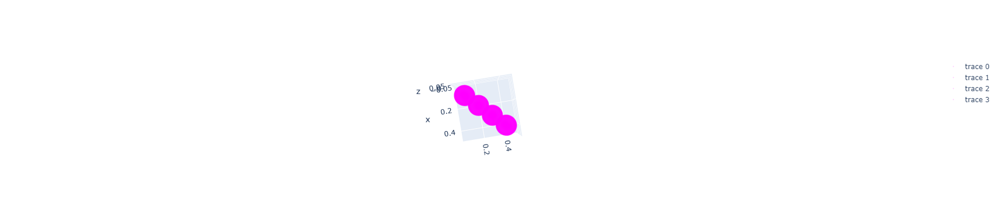

In [14]:
import plotly.graph_objects as go
import numpy as np

# Sphere parameters
r = 0.08  # radius
centers = [[0.4, 0.4, 0], [0.2, 0.2, 0], [0.1, 0.1, 0], [0.3, 0.3, 0.0]]

# Angular parameters for the sphere
theta = np.linspace(0, 2.*np.pi, 100)
phi = np.linspace(0, np.pi, 100)
theta, phi = np.meshgrid(theta, phi)
theta, phi = theta.flatten(), phi.flatten()

# Cartesian coordinates of the sphere
xs = [centers[i][0] + r * np.sin(phi) * np.cos(theta) for i in range(len(centers))]
ys = [centers[i][1] + r * np.sin(phi) * np.sin(theta) for i in range(len(centers))]
zs = [centers[i][2] + r * np.cos(phi) for i in range(len(centers))]


# Cartesian coordinates of the sphere
x1 = center1[0] + r * np.sin(phi) * np.cos(theta)
y1 = center1[1] + r * np.sin(phi) * np.sin(theta)
z1 = center1[2] + r * np.cos(phi)

# Create a scatter plot for the sphere
fig = go.Figure(data=[*[go.Scatter3d(
    x=xs[i], y=ys[i], z=zs[i],
    mode='markers',
    marker=dict(
        size=2,
        color='magenta',  # Sphere color
        opacity=0.05    # Sphere opacity
    )
) for i in range(len(centers))]])

fig.show()


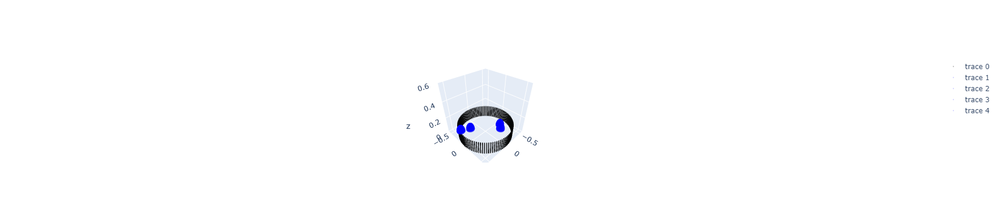

In [23]:
import plotly.graph_objects as go
import numpy as np

# The cylinder's parameters
z_cylinder = np.linspace(0, .15, 100)  # The z-values range from 0 (the bottom of the cylinder) to 15 (the top)
theta_cylinder = np.linspace(0, 2*np.pi, 100)  # To cover the entire circumference of the cylinder
z_cylinder, theta_cylinder = np.meshgrid(z_cylinder, theta_cylinder)
x_cylinder = .60*np.cos(theta_cylinder)  # X and Y coordinates based on the radius of the cylinder
y_cylinder = .60*np.sin(theta_cylinder)

# The sphere's parameters
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)

# Angular parameters for the sphere
# Sphere parameters
r = 0.08  # radius
centers = [[0.4, -0.4, 0], [0.2, -0.3, 0], [-0.4, 0.1, 0], [-0.3, 0.2, 0.0]]
theta = np.linspace(0, 2.*np.pi, 100)
phi = np.linspace(0, np.pi, 100)
theta, phi = np.meshgrid(theta, phi)
theta, phi = theta.flatten(), phi.flatten()

# Cartesian coordinates of the sphere
xs = [centers[i][0] + r * np.sin(phi) * np.cos(theta) for i in range(len(centers))]
ys = [centers[i][1] + r * np.sin(phi) * np.sin(theta) for i in range(len(centers))]
zs = [centers[i][2] + r * np.cos(phi) for i in range(len(centers))]


# Plot
fig = go.Figure(data=[
    # The cylinder
    go.Scatter3d(
        x=x_cylinder.ravel(),
        y=y_cylinder.ravel(),
        z=z_cylinder.ravel(),
        mode='markers',
        marker=dict(
            size=1,
            color='black',   # Cylinder color
            opacity=0.3     # Cylinder opacity
        )
    ),
    # The spheres
    *[go.Scatter3d(
        x=xs[i], y=ys[i], z=zs[i],
        mode='markers',
        marker=dict(
            size=2,
            color='blue',  # Sphere color
            opacity=0.05    # Sphere opacity
        )
    ) for i in range(len(centers))]
])

fig.update_layout(
    scene=dict(
        xaxis=dict(range=[-0.6, 0.6]),
        yaxis=dict(range=[-0.6, 0.6]),
        zaxis=dict(range=[0, 0.6])
    )
)
# fig.write_html('fig.html', auto_open=True)
fig.show()

In [13]:
df.fixation

0       False
1       False
2       False
3       False
4        True
        ...  
1075     True
1076     True
1077     True
1078     True
1079     True
Name: fixation, Length: 1080, dtype: bool

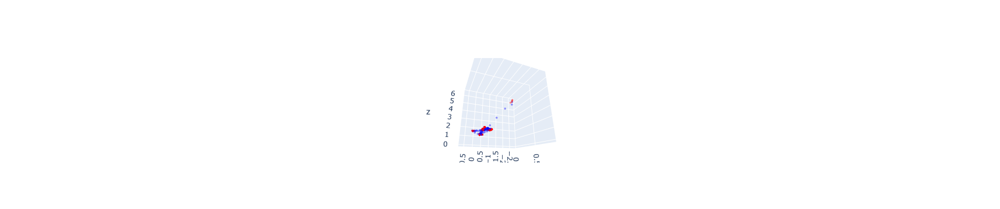

In [15]:
import plotly.graph_objects as go
import plotly.express as px
import numpy as np


df = f_tps.copy()
# Assuming df is your DataFrame and it contains columns for 'x', 'y', 'z', 'labels', 'camera_x', 'camera_y', 'camera_z'
# For labels color coding, you might need to map them into colors

# Create a dictionary mapping labels to colors
label_color_dict = {False: 'blue', True: 'red'}  # add your real labels and desired colors

# Compute the mean camera position
mean_camera_x = np.mean(df['camera_x'])
mean_camera_y = np.mean(df['camera_y'])
mean_camera_z = np.mean(df['camera_z'])

df['color'] = df['fixation'].map(label_color_dict)

# Create the 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=df['gaze_collision_x'],
    y=df['gaze_collision_y'],
    z=df['gaze_collision_z'],
    mode='markers',
    marker=dict(
        size=2,
        color=df['color'],
        opacity = 0.4,                # set color to an array/list of desired values
    )
)])



# Set the camera position
camera = dict(
    eye=dict(x=mean_camera_x, y=mean_camera_y, z=mean_camera_z)
)

fig.update_layout(scene_camera=camera)
# fig.write_html('first_figure.html', auto_open=True)

fig.show()


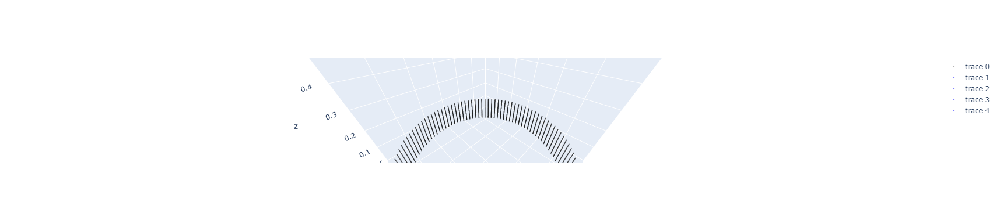